<a href="https://colab.research.google.com/github/Pavionio/Fear_and_Hate_in_Taxi/blob/main/clean_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 42.1 MB/s eta 0:00:00


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.ticker import MaxNLocator
import random
import geopy.distance as gp
import plotly.express as px
import math
import geopandas as gpd
from shapely.geometry import Point
import shapely
import json

In [4]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [16]:
trip_duration = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/nyc_taxi_trip_duration.csv')
weather = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/nyc_2016_weather.csv')

# **Предобработка**

In [17]:
weather['precipitation'] = weather['precipitation'].replace('T', 0).astype('float64')
weather['snow fall'] = weather['snow fall'].replace('T', 0).astype('float64')
weather['snow depth'] = weather['snow depth'].replace('T', 0).astype('float64')

In [ ]:
weather.info()

In [6]:
def get_distance(p1, p2):
    # p1 и p2 - это кортежи из двух элементов - координаты точек
    radius = 6373.0

    lon1 = math.radians(p1[0])
    lat1 = math.radians(p1[1])
    lon2 = math.radians(p2[0])
    lat2 = math.radians(p2[1])

    d_lon = lon2 - lon1
    d_lat = lat2 - lat1

    a = math.sin(d_lat / 2) ** 2 + math.cos(lat1) * math.cos(lat2) * math.sin(d_lon / 2) ** 2
    c = 2 * math.atan2(a ** 0.5, (1 - a) ** 0.5)

    distance = radius * c
    return distance

In [18]:
trip_duration['distance'] = trip_duration.apply(lambda x: get_distance((x.pickup_longitude, x.pickup_latitude), (x.dropoff_longitude, x.dropoff_latitude)), axis=1)
trip_duration['avg_speed'] = trip_duration.distance /  trip_duration.trip_duration * 3600 # км / ч

In [ ]:
df = pd.read_csv('/content/gdrive/MyDrive/intensive/Project/taxi_zones.csv')

# **Исключения выбросов**

In [ ]:
polygon = gpd.GeoDataFrame(geometry=shapely.wkt.loads(df.the_geom))

ls=[]

for _,row in trip_duration.iterrows():
  ls.append(polygon.contains(Point(row[5],row[6])).any() and polygon.contains(Point(row[7],row[8])).any())

In [ ]:
trip_duration[list(map(lambda x: not(x), ls))].to_csv('distace_anomalies.csv', index=False)
len(trip_duration[ls]), len(trip_duration)

In [ ]:
trip_duration=trip_duration.merge(weather, how='left', left_on=pd.to_datetime(trip_duration['pickup_datetime']).dt.date, right_on=pd.to_datetime(weather['date']).dt.date)[ls]

In [ ]:
trip_duration.to_csv('distace_filtered_duration_weather.csv', index=False)

In [ ]:
trip_duration.sort_values(by=['pickup_datetime','dropoff_datetime'],inplace=True)

In [ ]:
trip_duration = trip_duration[(trip_duration.passenger_count < 9) & (trip_duration.avg_speed != 0) & (trip_duration.passenger_count> 0)]

<ipython-input-86-c0821c4e79eb>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_duration.sort_values(by=['distance'],inplace=True)


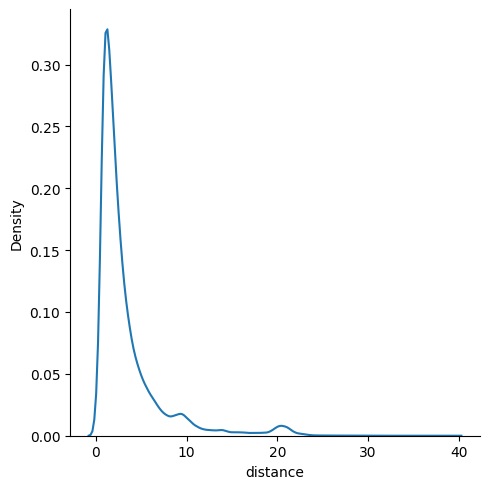

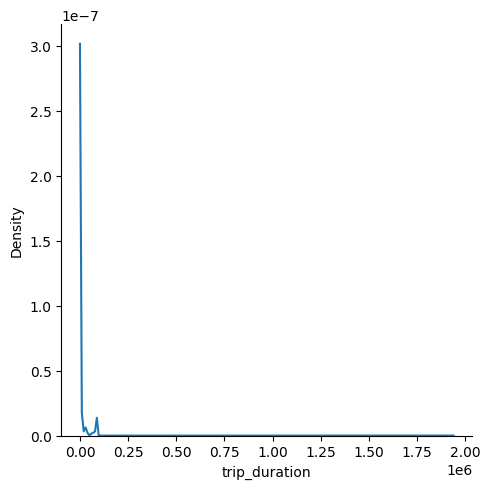

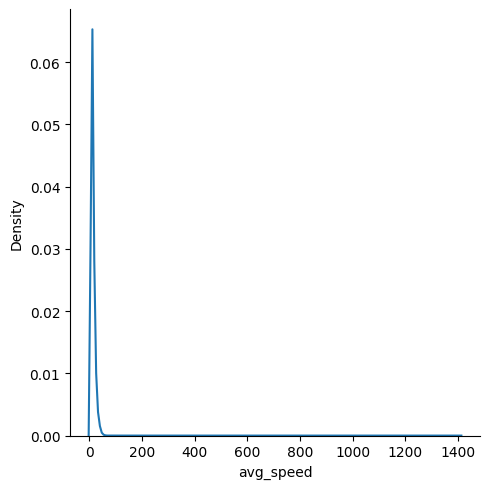

In [ ]:
trip_duration.sort_values(by=['distance'],inplace=True)
sns.displot(trip_duration.distance, kind="kde")
sns.displot(trip_duration.trip_duration, kind="kde")
sns.displot(trip_duration.avg_speed, kind="kde")

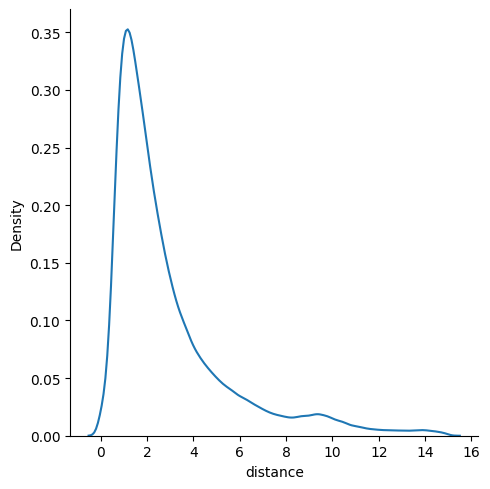

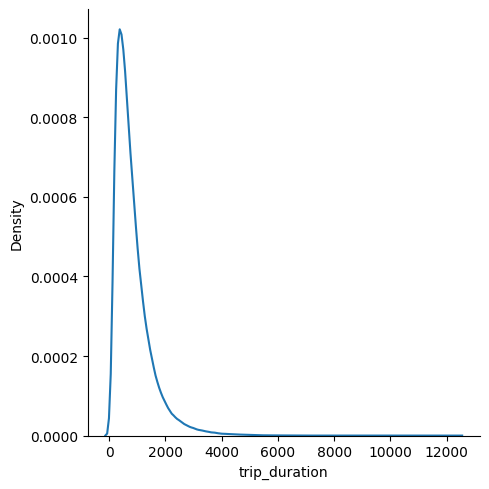

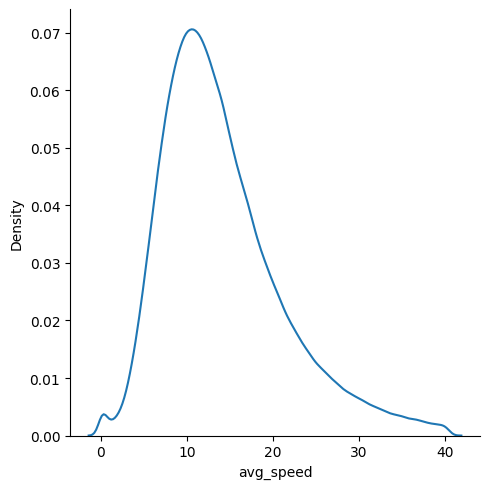

In [ ]:
def mask_f(col):
  return (col.mean() - 3*col.std()), (col.mean()  + 3*col.std())


mask = mask_f(trip_duration.distance)
sns.displot(trip_duration.distance[(trip_duration.distance > mask[0]) & (trip_duration.distance < mask[1])], kind="kde")
mask = mask_f(trip_duration.trip_duration)
sns.displot(trip_duration.trip_duration[(trip_duration.distance > mask[0]) & (trip_duration.trip_duration < mask[1])], kind="kde")
mask = mask_f(trip_duration.avg_speed)
sns.displot(trip_duration.avg_speed[(trip_duration.avg_speed > mask[0]) & (trip_duration.avg_speed < mask[1])], kind="kde")

# **Зависимости поездок и погодных явлений**

In [21]:
trip_duration['day'] = pd.to_datetime(trip_duration['pickup_datetime'].str.slice(stop=10))

In [22]:
weather_analisys = trip_duration.groupby('day',as_index=False).agg({'id': 'count', 'maximum temperature' :'mean','minimum temperature' :'mean',
                                                     'average temperature' :'mean', 'precipitation': 'mean', 'snow fall' : 'mean', 'snow depth' : 'mean', 'distance': 'mean','avg_speed': 'mean'})
weather_analisys.rename(columns={"id": "taxi_count"},inplace=True)

<Axes: >

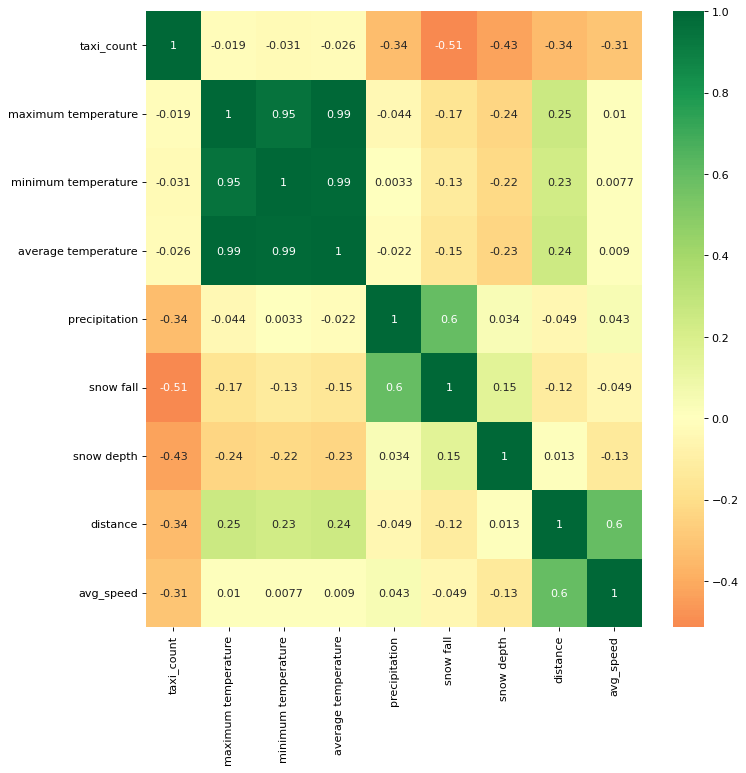

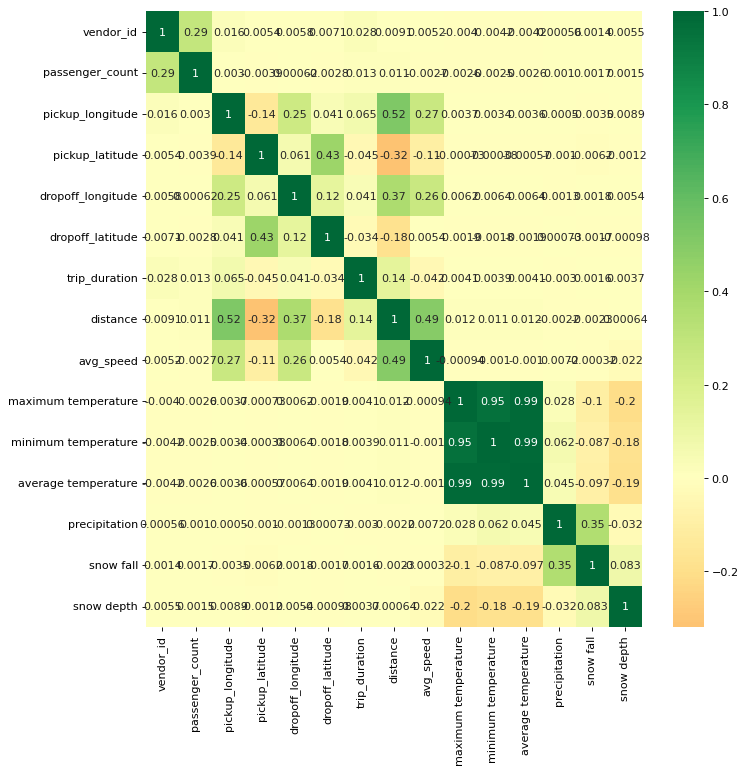

In [ ]:
corr = weather_analisys.corr()

plt.figure(figsize=(10,10), dpi= 80)
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, cmap='RdYlGn', center=0, annot=True)

corr = trip_duration.corr()

plt.figure(figsize=(10,10), dpi= 80)
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, cmap='RdYlGn', center=0, annot=True)

<Figure size 1000x1000 with 0 Axes>

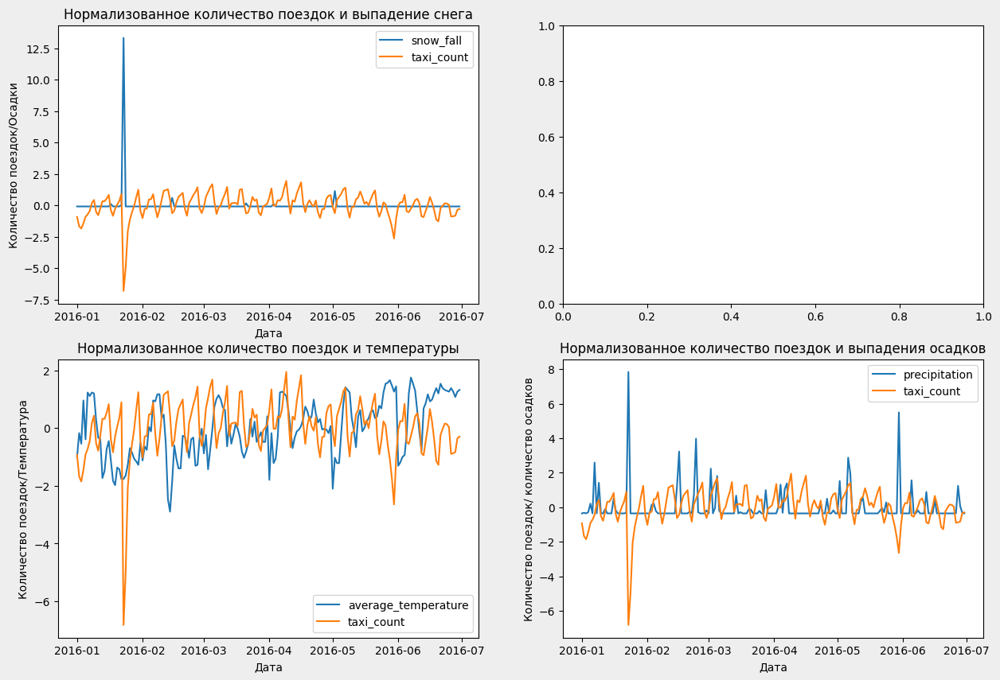

In [ ]:
fig = plt.figure(figsize=(10,10))

f, ax = plt.subplots(2,2)# краще выглядит 

f.set_size_inches(15, 10)     # размер 7 x 4 дюймов
f.set_facecolor('#eee')

snow_fall = (weather_analisys['snow fall'] - weather_analisys['snow fall'].mean()) / weather_analisys['snow fall'].std()
taxi_count= (weather_analisys['taxi_count'] - weather_analisys['taxi_count'].mean()) /  weather_analisys['taxi_count'].std()
average_temperature = (weather_analisys['average temperature'] - weather_analisys['average temperature'].mean()) / weather_analisys['average temperature'].std()
precipitation = (weather_analisys['precipitation'] - weather_analisys['precipitation'].mean()) / weather_analisys['precipitation'].std()

ax[0,0].plot(weather_analisys['day'], snow_fall,label = 'snow_fall')
ax[0,0].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[0,0].set(title='Нормализованное количество поездок и выпадение снега',ylabel='Количество поездок/Осадки',xlabel='Дата')
ax[0,0].legend()



ax[1,0].plot(weather_analisys['day'], average_temperature,label = 'average_temperature')
ax[1,0].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[1,0].set(title='Нормализованное количество поездок и температуры',ylabel='Количество поездок/Температура',xlabel='Дата')
ax[1,0].legend()

ax[1,1].plot(weather_analisys['day'], precipitation,label = 'precipitation')
ax[1,1].plot(weather_analisys['day'], taxi_count,label = 'taxi_count')
ax[1,1].set(title='Нормализованное количество поездок и выпадения осадков',ylabel='Количество поездок/ количество осадков',xlabel='Дата')
ax[1,1].legend()

# **Временные ряды**

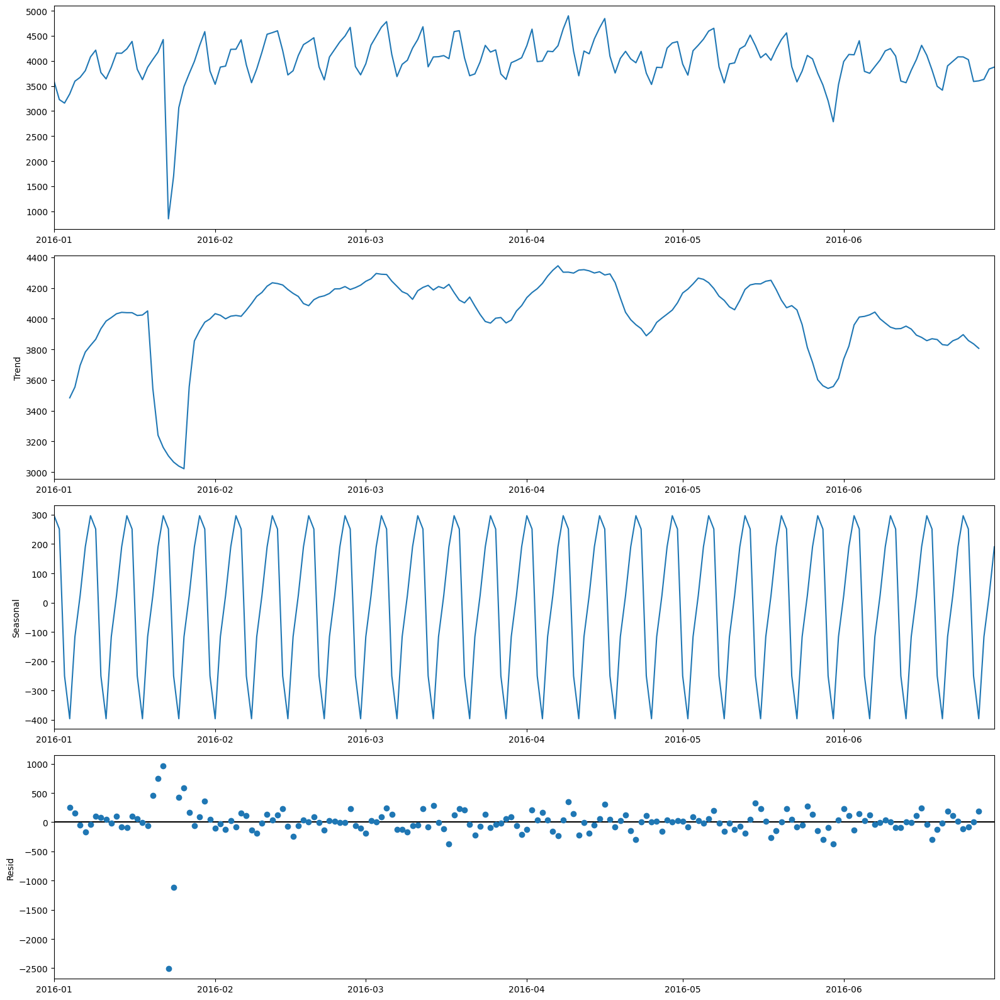

In [23]:
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib.pyplot import figure
data = weather_analisys.sort_values(by=['day']).loc[:, ('day','taxi_count')].set_index('day')
decomposition = seasonal_decompose(data, period=7)

fig = decomposition.plot()
fig.set_size_inches((16, 16))
# Tight layout to realign things
fig.tight_layout()
plt.show()

In [112]:
from sklearn.ensemble import IsolationForest

# normal_seasonal = ((decomposition.seasonal- c.mean()) /  c.std()).to_numpy().reshape(-1,1)
# normal_taxi_count = ((weather_analisys['taxi_count'] - c.mean()) /  c.std()).to_numpy().reshape(-1,1)

clf = IsolationForest(random_state=0).fit(weather_analisys[['taxi_count']] )
pred = clf.predict(weather_analisys[['taxi_count']])


In [113]:
weather_analisys['classification'] = pred

<Axes: xlabel='day'>

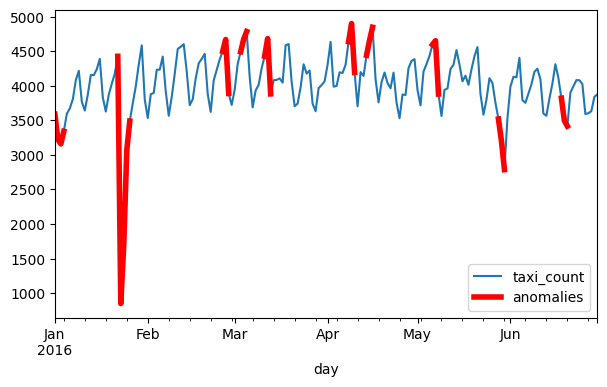

In [174]:
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()


rt = True
i =1
while i < len(df_out)-1:
    if df_out.iloc[i+1,2] == -1:
        i+=2
        rt = False

    elif rt:
      df_out.iloc[i,1] = np.NaN
      i+=1
      rt= True
    else:
      rt= True
      i+=1

fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

df_in.plot(x='day',y='taxi_count',ax=ax)
df_out.plot(x='day',y='taxi_count',ax=ax,c='red',linewidth= 4,label='anomalies')

<Axes: xlabel='day'>

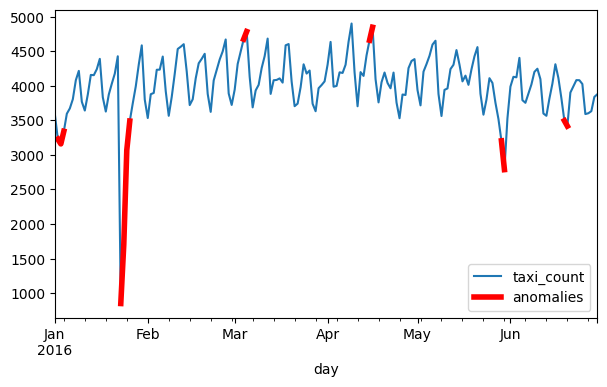

In [168]:
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()



df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN


fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

df_in.plot(x='day',y='taxi_count',ax=ax)
df_out.plot(x='day',y='taxi_count',ax=ax,c='red',linewidth= 4,label='anomalies')

<Axes: xlabel='day', ylabel='taxi_count'>

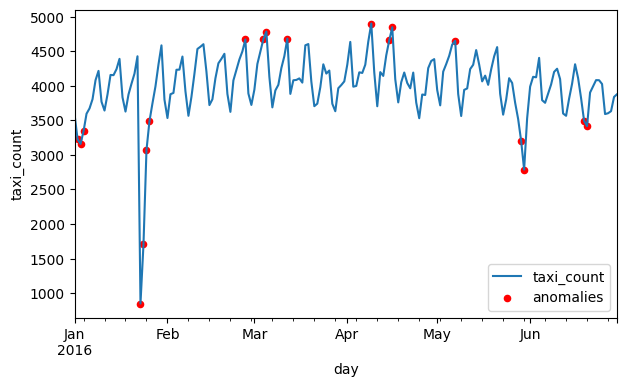

In [176]:
df_in = weather_analisys[['day','taxi_count','classification']].copy()
df_out = weather_analisys[['day','taxi_count','classification']].copy()



df_out.loc[df_in.classification == 1,'taxi_count'] = np.NaN


fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot()

df_in.plot(x='day',y='taxi_count',ax=ax)
df_out.plot.scatter(x='day',y='taxi_count',ax=ax,c='red',label='anomalies')

In [161]:
df_out.classification

0      1.0
1     -1.0
2     -1.0
3     -1.0
4      NaN
      ... 
177    NaN
178    NaN
179    NaN
180    NaN
181    1.0
Name: classification, Length: 182, dtype: float64

In [58]:
c = np.concatenate([decomposition.seasonal.to_numpy(),weather_analisys['taxi_count'].to_numpy()])

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#generate some fake data
x = np.random.random(10000)*10
y = np.random.random(10000)*10

col = np.where(x<1,'k',np.where(y<5,'b','r'))

plt.plot(x, y, c=col, s=5, linewidth=0)
plt.show()

# **Карты**

In [ ]:
pickup_longitude = trip_duration[['id', 'pickup_longitude']].rename(columns={'pickup_longitude': 'longitude'})
pickup_longitude['type'] = 'pickup'
dropoff_longitude = trip_duration[['id', 'dropoff_longitude']].rename(columns={'dropoff_longitude': 'longitude'})
dropoff_longitude['type'] = 'dropoff'

longitudes = pd.concat((pickup_longitude, dropoff_longitude))

pickup_latitude = trip_duration[['id', 'pickup_latitude']].rename(columns={'pickup_latitude': 'latitude'})
pickup_latitude['type'] = 'pickup'
dropoff_latitude = trip_duration[['id', 'dropoff_latitude']].rename(columns={'dropoff_latitude': 'latitude'})
dropoff_latitude['type'] = 'dropoff'

latitudes = pd.concat((pickup_latitude, dropoff_latitude))

coords = pd.merge(longitudes, latitudes, on=['id', 'type'])

In [ ]:
with open('/content/gdrive/MyDrive/intensive/Project/NYC Taxi Zones.geojson') as f:
    taxi_zones = json.load(f)

fig = px.scatter_mapbox(coords.iloc[1000000:,:], lat='latitude', lon='longitude', hover_name='type')
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(mapbox_bounds={"west": -180, "east": -50, "south": 20, "north": 90})
fig.update_traces(cluster=dict(enabled=True))
fig.update_layout(
    mapbox = {
        'style': "open-street-map",
        'center': { 'lon': -73.9662, 'lat': 40.7834},
        'zoom': 9, 'layers': [{
            'source': taxi_zones,
            'type': "fill", 'below': "traces", 'color': "gray", 'name': 'Область работы такси',
        'opacity': 0.5}]},
    margin = {'l':0, 'r':0, 'b':0, 't':0})
fig.show()

In [ ]:
coords

,id,longitude,type,latitude
0,id3888279,-73.982292,pickup,40.751331
1,id0924227,-73.970108,pickup,40.759800
2,id2914314,-73.985443,pickup,40.735710
3,id3968582,-73.993973,pickup,40.740868
4,id2563820,-73.959511,pickup,40.762810
...,...,...,...,...
1449205,id3674376,-73.911179,dropoff,40.767735
1449206,id1785039,-73.950737,dropoff,40.693722
1449207,id3012598,-73.988182,dropoff,40.769695
1449208,id0376262,-73.926704,dropoff,40.856739


In [ ]:
import folium
from folium import plugins
from IPython.display import HTML, display,IFrame
mymap = folium.Map(location=[41., -74], zoom_start=8 )

#for lat, lon in zip(test['pickup_latitude'],test['pickup_longitude']):
#    folium.CircleMarker([lat, lon],radius=4, color='black',
#                    fill_color='red', fill_opacity=0.5, opacity=0.4).add_to(map)
#map

taxi = coords.loc[:,('longitude', 'latitude')].values

# plot heatmap
mymap.add_child(plugins.HeatMap(taxi, radius=15))
mymap.save('plot_data.html')
IFrame('plot_data.html', width=700, height=350)